## Background
Most of the simulation/plotting work so far has used `mne` in some way, but as this is supposed to be a generalizable `element workflow`, I want to try to strip out MNE as much as possible (I can put those mne bits into a contextualized `community workflow` - mne-eeg-viewer).

## Tasks: 
1. generate data
    - create an eeg data generator that returns eeg data as a numpy array (channels, times)
        - Right now, it's not essential for us to simulate EEG data that appears convincingly real. Instead, our priority should be to generate EEG-like time-series that embody the specifications that could influence the development and visualization process. For this reason, variable frequency sine waves with some level of noise might suffice, as long as they are produced at with relevant aspects like sampling rate, dtype, and signal scale.
        - update - [neurodsp](https://github.com/neurodsp-tools/neurodsp) seems to have a simple 1/f eeg data simulator.. I may try theirs
    - also generate a times array, channel names, and channel types
    - maybe: generate events - condition, epoch arrays
    - maybe maybe: generate - locations
    - probably not yet: other data types (meg, eog)
    - don't create anything on-disk (yet)... the most generalizable starting point is an in-memory numpy array and some info objects.
2. plot a generalizeable eeg-viewer
    - plot a simple eeg-viewer
    - include a minimap of some sort
        - [how to make the minimap start in bbox](https://stackoverflow.com/questions/73647097/predefine-selection-of-holoviews-rangetoollink)
    - color according to channel type
    - try holonote on it, add UI elements
    - note: If it helps in some way (like for API into a plot lib), I can wrap the eeg data numpy array into a container like pandas or xarray (I think wrapping does **not** make a copy as long I don't alter the array).

## Generate pink noise EEG data

The term "pink noise" is commonly used to refer to the power spectral density (PSD) characteristics of the noise signal, where the PSD follows a power-law distribution with a slope of approximately -1. This term is widely recognized and associated with noise signals that exhibit an equal amount of energy per octave or per frequency interval. This property of pink noise captures the statistical characteristics and fractal-like properties observed in the background activity of the brain.

In [40]:
import numpy as np
from scipy import signal

def generate_eeg_pinknoise(channels: int, duration: float, sampling_rate: int,
                           highpass: float = 1.0) -> tuple[np.ndarray, np.ndarray]:
    """
    Generate synthetic EEG data with pink noise characteristics.

    Args:
        channels (int): Number of EEG channels.
        duration (float): Duration of the EEG data in seconds.
        sampling_rate (int): Sampling rate of the EEG data in Hz.
        highpass (float, optional): High-pass filter factor in Hz. Frequencies lower than
            this value will be attenuated. Defaults to 1.0. Should be greater than 0.

    Returns:
        tuple[np.ndarray, np.ndarray]: Synthetic EEG data as a NumPy array of shape (channels, total_samples),
                                       and time array as a NumPy array of shape (total_samples,).

    """
    total_samples = int(duration * sampling_rate)
    time = np.arange(total_samples) / sampling_rate

    # Generate white noise
    white_noise = np.random.normal(0, 1, (channels, total_samples))

    # Apply 1/f filter to shape the noise spectrum
    b, a = signal.butter(1, highpass / (sampling_rate / 2), btype='highpass')
    pink_noise = signal.filtfilt(b, a, white_noise, axis=1)

    # Scale the pink noise by the desired amplitude
    amplitude = 100 # EEG signals are typically plus or minus 100 microvolts
    scaled_noise = pink_noise * amplitude

    # Check dimensions of the generated data
    assert pink_noise.shape == (channels, total_samples), "Incorrect dimensions for pink_noise array"

    return pink_noise, time


In [41]:
channels = 50
duration = 10  # seconds
sampling_rate = 500  # Hz
highpass = 1  # Hz (default)

data, time = generate_eeg_pinknoise(channels, duration, sampling_rate, highpass)

In [42]:
data.shape

(50, 5000)

## Visualize EEG

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
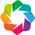

In [6]:
import holoviews as hv
hv.extension('bokeh')

def view_eeg(data, time, ch_names=None, spacing=2):

    n_channels = data.shape[0]
    
    if ch_names is None:
        # Create a channel names list
        ch_names = [f'EEG {i+1}' for i in range(n_channels)]

    # Calculate the offset between channels to avoid visual overlap
    offset = np.max(np.abs(data)) * spacing

    # Create a hv.Curve element per chan
    channel_curves = {}
    for i, channel_data in enumerate(data):
        channel_curves[ch_names[i]] = hv.Curve((time, channel_data + (i * offset)), 'Time').opts(color='black', line_width=1, tools=['hover'])

    # Create mapping from yaxis location to ytick for each channel
    yticks = [(i * offset, channel_name) for i, channel_name in enumerate(ch_names)]

    # Create hv overlay of curves
    eeg_viewer = hv.NdOverlay(channel_curves, kdims='Channel').opts(
        width=600, height=600, padding=.01, xlabel='Time', ylabel='Channel', yticks=yticks, show_legend=False)

    return eeg_viewer

In [44]:
view_eeg(data, time)

:NdOverlay   [Channel]
   :Curve   [Time]   (y)

## that still does not look great.. try brown noise:

In [66]:
import numpy as np
from scipy import signal

def generate_eeg_brownnoise(channels: int, duration: float, sampling_rate: int,
                            highpass: float = 2.0, amplitude: float = 100.0) -> tuple[np.ndarray, np.ndarray]:
    """
    Generate synthetic EEG data with brown noise characteristics.

    Args:
        channels (int): Number of EEG channels.
        duration (float): Duration of the EEG data in seconds.
        sampling_rate (int): Sampling rate of the EEG data in Hz.
        highpass (float, optional): High-pass filter factor in Hz. Frequencies lower than
            this value will be attenuated. Should be greater than 0. Defaults to 2.0.
        amplitude (float, optional): Amplitude scaling factor for the generated EEG data.
            Defaults to 100.0 microvolts.

    Returns:
        tuple[np.ndarray, np.ndarray]: Synthetic EEG data as a NumPy array of shape (channels, total_samples),
                                       and time array as a NumPy array of shape (total_samples,).

    """
    desired_samples = int(duration * sampling_rate)
    total_samples = int(desired_samples * 1.2)  # Generate a longer time series

    time = np.arange(total_samples) / sampling_rate

    # Generate white noise
    white_noise = np.random.normal(0, 1, (channels, total_samples))

    # Apply 1/f^2 filter to shape the noise spectrum
    b, a = signal.butter(2, highpass / (sampling_rate / 2), btype='highpass')
    brown_noise = signal.filtfilt(b, a, white_noise, axis=1)

    # Integrate the brown noise to achieve the brown noise characteristics
    integrated_noise = np.cumsum(brown_noise, axis=1)

    # Extract the desired duration from the center of the time series
    start_idx = int((total_samples - desired_samples) / 2)
    end_idx = start_idx + desired_samples
    extracted_noise = integrated_noise[:, start_idx:end_idx]

    # Scale the extracted noise by the desired amplitude
    scaled_noise = extracted_noise * amplitude

    # Adjust the time vector to match the dimensions of the scaled noise
    time = time[start_idx:end_idx]

    # Check dimensions of the generated data
    assert scaled_noise.shape == (channels, desired_samples), "Incorrect dimensions for scaled_noise array"
    assert time.shape == (desired_samples,), "Incorrect dimensions for time array"

    return scaled_noise, time


In [67]:
channels = 50
duration = 10  # seconds
sampling_rate = 500  # Hz
highpass = 2  # Hz (default)

data, time = generate_eeg_brownnoise(channels, duration, sampling_rate, highpass)

In [68]:
view_eeg(data, time)

:NdOverlay   [Channel]
   :Curve   [Time]   (y)

## that still looks pretty bad. try neurodsp instead

In [4]:
import numpy as np
from neurodsp.sim import sim_powerlaw

def generate_eeg_brownnoise(n_channels: int, n_seconds: float, fs: int,
                            highpass: float = 2.0, amplitude: float = 50.0) -> tuple[np.ndarray, np.ndarray]:
    """
    Generate synthetic EEG data with brown noise characteristics.

    Args:
        n_channels (int): Number of EEG channels.
        n_seconds (float): Duration of the EEG data in seconds.
        fs (int): Sampling rate of the EEG data in Hz.
        highpass (float, optional): High-pass filter factor in Hz. Frequencies lower than
            this value will be attenuated. Should be greater than 0. Defaults to 2.0.
        amplitude (float, optional): Amplitude scaling factor for the generated EEG data.
            Defaults to 50.0 microvolts.

    Returns:
        tuple[np.ndarray, np.ndarray]: Synthetic EEG data as a NumPy array of shape (channels, total_samples),
                                       and time array as a NumPy array of shape (total_samples,).

    """
    total_samples = int(n_seconds * sampling_rate)

    # Generate high-passed brown noise for each channel
    scaled_noise = np.empty((n_channels, total_samples))
    for ch in range(channels):
        brown_noise = sim_powerlaw(n_seconds, fs, f_range=(highpass, None))
        scaled_noise[ch] = brown_noise * amplitude

    time = np.arange(total_samples) / sampling_rate

    # Check dimensions of the generated data
    assert scaled_noise.shape == (channels, total_samples), "Incorrect dimensions for scaled_noise array"
    assert time.shape == (total_samples,), "Incorrect dimensions for time array"

    return scaled_noise, time


In [85]:
channels = 50
duration = 10  # seconds
sampling_rate = 500  # Hz

data, time = generate_eeg_brownnoise(channels, duration, sampling_rate, highpass)

In [86]:
data.shape

(50, 5000)

In [87]:
view_eeg(data, time)

:NdOverlay   [Channel]
   :Curve   [Time]   (y)

## That looks good enough!

In [88]:
import pandas as pd
import hvplot.pandas
df = pd.DataFrame(data.T)
df.hvplot.hist()

:NdOverlay   [Element]
   :Histogram   [49]   (49_count)

In [117]:
import scipy.signal as signal

frequencies, psd = signal.periodogram(data.flatten(), fs=sampling_rate)

In [118]:
df_psd = pd.DataFrame({'Frequency': frequencies, 'PSD': psd})
df_psd.hvplot.line(x='Frequency', y='PSD', logx=True, logy=True, xlim=[.1,100], ylim=[.001, 10000])

:Curve   [Frequency]   (PSD)

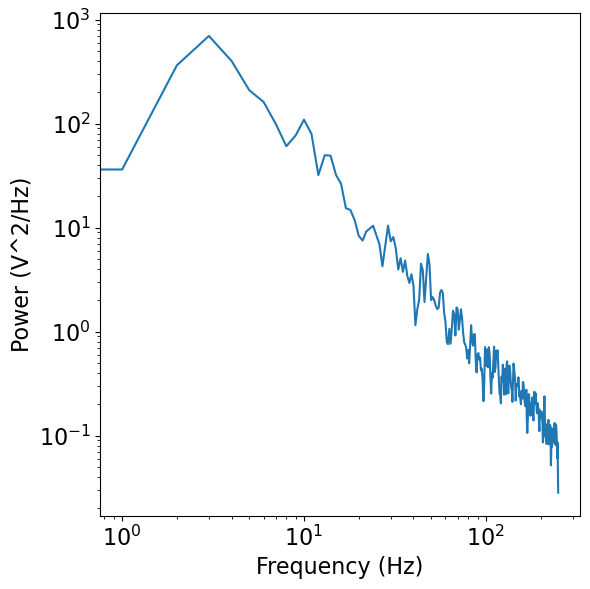

In [107]:
from neurodsp.spectral import compute_spectrum
from neurodsp.plts.spectral import plot_power_spectra

freqs, psd = compute_spectrum(data[0,:], sampling_rate)
plot_power_spectra(freqs, psd)

## from script

In [5]:
from neurodatagen.eeg import generate_eeg_brown

n_channels = 50
n_seconds = 10
fs = 500

data, time = generate_eeg_brown(n_channels, n_seconds, fs)

In [7]:
view_eeg(data, time)

:NdOverlay   [Channel]
   :Curve   [Time]   (y)